In [212]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Circle
import folium
import seaborn as sns
import numpy as np
import pickle

from sklearn.preprocessing import OneHotEncoder, StandardScaler

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import davies_bouldin_score
from sklearn.metrics import silhouette_score

pd.set_option("display.max_rows", 101)
pd.options.display.max_columns = 999

In [213]:
data = pd.read_csv('C:\\Users\\dtulomba\\Documents\\ProjetsCours\\projet5\\olist_customers_dataset.csv\\data_cleaned.csv', sep=',')

In [214]:
data = data.rename(columns={'recency': 'Nb_inactive_days'})

In [215]:
data = data.rename(columns={'monetary': 'montant'})

In [216]:
data

,customer_unique_id,Nb_inactive_days,frequency,montant,note_com,frais_livraison,temps_moyen_livraison,Alimentation et Boissons,Auto et Moto,Autres,Livres et Médias,Maison et Jardin,Mode,Santé et Beauté,Sports et Loisirs,Électronique
0,0000366f3b9a7992bf8c76cfdf3221e2,111,1,141.90,5.0,12.00,6.0,0,0,0,0,1,0,0,0,0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,27.19,4.0,8.29,3.0,0,0,0,0,0,0,1,0,0
2,0000f46a3911fa3c0805444483337064,536,1,86.22,3.0,17.22,25.0,0,0,0,0,0,0,0,0,0
3,0000f6ccb0745a6a4b88665a16c9f078,320,1,43.62,4.0,17.63,20.0,0,0,0,0,0,0,0,0,1
4,0004aac84e0df4da2b147fca70cf8255,287,1,196.89,5.0,16.89,13.0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
92488,fffcf5a5ff07b0908bd4e2dbc735a684,446,2,4134.84,5.0,248.71,27.0,0,0,0,0,0,0,2,0,0
92489,fffea47cd6d3cc0a88bd621562a9d061,261,1,84.58,4.0,19.69,30.0,0,0,0,0,0,0,1,0,0
92490,ffff371b4d645b6ecea244b27531430a,567,1,112.46,5.0,22.56,14.0,0,1,0,0,0,0,0,0,0
92491,ffff5962728ec6157033ef9805bacc48,118,1,133.69,5.0,18.69,11.0,0,0,0,0,0,1,0,0,0


In [217]:
data.columns

Index(['customer_unique_id', 'Nb_inactive_days', 'frequency', 'montant',
       'note_com', 'frais_livraison', 'temps_moyen_livraison',
       'Alimentation et Boissons', 'Auto et Moto', 'Autres',
       'Livres et Médias', 'Maison et Jardin', 'Mode', 'Santé et Beauté',
       'Sports et Loisirs', 'Électronique'],
      dtype='object')

In [218]:
data.shape

(92493, 16)

In [219]:
data.columns.to_list()

['customer_unique_id',
 'Nb_inactive_days',
 'frequency',
 'montant',
 'note_com',
 'frais_livraison',
 'temps_moyen_livraison',
 'Alimentation et Boissons',
 'Auto et Moto',
 'Autres',
 'Livres et Médias',
 'Maison et Jardin',
 'Mode',
 'Santé et Beauté',
 'Sports et Loisirs',
 'Électronique']

In [220]:
segment_1 = data[['customer_unique_id','Nb_inactive_days','frequency','montant']]  # Correspond à table RFM
segment_2 = data[['customer_unique_id','Nb_inactive_days','frequency','montant','note_com','frais_livraison','temps_moyen_livraison']]
segment_3 = data

In [221]:
segment_1.head()

,customer_unique_id,Nb_inactive_days,frequency,montant
0,0000366f3b9a7992bf8c76cfdf3221e2,111,1,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,27.19
2,0000f46a3911fa3c0805444483337064,536,1,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,320,1,43.62
4,0004aac84e0df4da2b147fca70cf8255,287,1,196.89


In [222]:
segment_2.head()

,customer_unique_id,Nb_inactive_days,frequency,montant,note_com,frais_livraison,temps_moyen_livraison
0,0000366f3b9a7992bf8c76cfdf3221e2,111,1,141.90,5.0,12.00,6.0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,27.19,4.0,8.29,3.0
2,0000f46a3911fa3c0805444483337064,536,1,86.22,3.0,17.22,25.0
3,0000f6ccb0745a6a4b88665a16c9f078,320,1,43.62,4.0,17.63,20.0
4,0004aac84e0df4da2b147fca70cf8255,287,1,196.89,5.0,16.89,13.0


In [223]:
segment_3.head()

,customer_unique_id,Nb_inactive_days,frequency,montant,note_com,frais_livraison,temps_moyen_livraison,Alimentation et Boissons,Auto et Moto,Autres,Livres et Médias,Maison et Jardin,Mode,Santé et Beauté,Sports et Loisirs,Électronique
0,0000366f3b9a7992bf8c76cfdf3221e2,111,1,141.90,5.0,12.00,6.0,0,0,0,0,1,0,0,0,0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,27.19,4.0,8.29,3.0,0,0,0,0,0,0,1,0,0
2,0000f46a3911fa3c0805444483337064,536,1,86.22,3.0,17.22,25.0,0,0,0,0,0,0,0,0,0
3,0000f6ccb0745a6a4b88665a16c9f078,320,1,43.62,4.0,17.63,20.0,0,0,0,0,0,0,0,0,1
4,0004aac84e0df4da2b147fca70cf8255,287,1,196.89,5.0,16.89,13.0,0,0,0,0,0,0,0,0,1


Kmeans = classification non supervisé qui permets de regrouper les individus en plusieurs groupes homogènes. Pour cela nous avons besoin de savoir le nombre optimale de groupe à considéré et ce nombre là optimale on le fait en utilisant les metrics comme le score sylveste, calinski -> on utilise tout ça pour savoir le nombre des cluster optimale et ensuite on fait notre kmeans et enfin la caractérisation. La caractérisation c'est le fait de dire qu'il y a la radar plot -> ça permets de dire pour chaque cluster ce qu'on a comme variable c'est un cluster, c'est juste pour visualiser les clusters. Radar plot aide aussi à savoir quels sont les clients qui ont une fréquence élevé, un montant élevé etc etc 

In [224]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import yellowbrick
from yellowbrick.cluster import KElbowVisualizer
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, RobustScaler, MinMaxScaler
from sklearn.metrics.cluster import adjusted_rand_score

Ici nous allons standardiser les données, c'est à dire les mettre à la même échelle 

In [225]:
# StandardScaler
scaler = StandardScaler()

In [226]:
segment_1_copy=segment_1.drop(['customer_unique_id'], axis=1).copy()
#segment_1_sample_x = segment_1.sample(frac = .25, random_state = 42) # faire le cluster avec l'ensemble des données
segment_1_scaled = scaler.fit_transform (segment_1_copy)

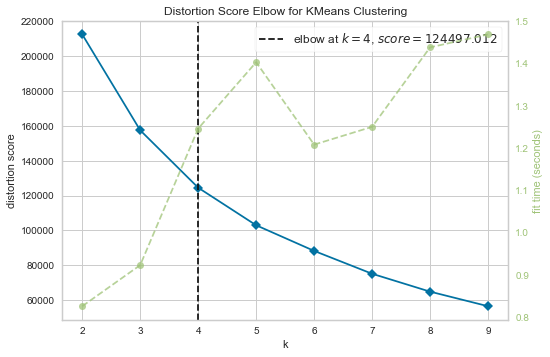



Nombre optimal de clusters pour segment_1 :  4
Score de silhouette pour segment_1 :  0.477953722637664
Labels de clusters pour segment_1 :  [2 2 1 ... 1 2 1]
Wall time: 2min 17s


In [227]:
# c'est juste pour avoir le temps
# ensuite on définit le modèle k_means, le n_init c'est le nombre d'initialisation à faire 
%%time
# Pour segment_1
model =KMeans(random_state=0,n_init=10)
visualizer_1 = KElbowVisualizer(model, k=(2, 10))#il va tester tout les modèles de Kmeans entre 2 et 10 où le nombre de cluster est compris entre 2 et 10 
visualizer_1.fit(segment_1_scaled)
visualizer_1.show()

#elbow_value nous donne le nombre des clusters optimale
# la distortion permets de déterminer le nombre des clusters optimales 
kmeans_1 = KMeans(n_clusters=visualizer_1.elbow_value_, random_state=0,n_init=10).fit(segment_1_scaled)
labels_1 = kmeans_1.labels_  # je peux utliser kmeans_1.predict (segement_1_sample)
score_1 = silhouette_score(segment_1_scaled, labels_1)

# score silhouette est un indicateur utilisé pour le kmeans pour comparer la qualité entre les clusters plus un cluster a un score élevé plus il est bien 
# calinski_harabasz score c'est le rapport entre la variance inter cluster divisé par la variance intra cluster -> on veut une faible variance intra cluster et une forte inter cluster car on veut que les clusters soient différents

print("\n")
print("Nombre optimal de clusters pour segment_1 : ", visualizer_1.elbow_value_)
print("Score de silhouette pour segment_1 : ", score_1)
print("Labels de clusters pour segment_1 : ", labels_1)

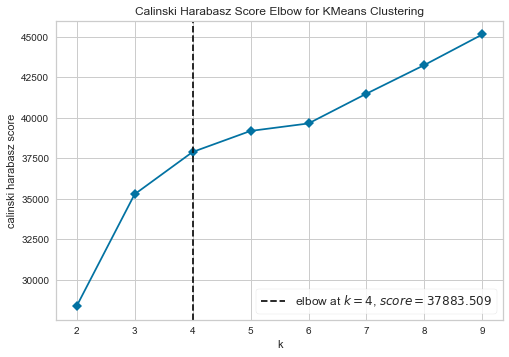

Wall time: 9.15 s


<AxesSubplot:title={'center':'Calinski Harabasz Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='calinski harabasz score'>

In [228]:
# on change juste la metric ici car par défaut c'est la distorsion -> donc on la change pour calculer un autre score
# timings=false signifie qu'on a pas besoin de la courbe verte car c'est une courbe de temps 
%%time
visualizer_1 = KElbowVisualizer(model, k=(2, 10), metric='calinski_harabasz', timings=False)
visualizer_1.fit(segment_1_scaled)
visualizer_1.show()
#plt.title('Elbow method pour segment_1')

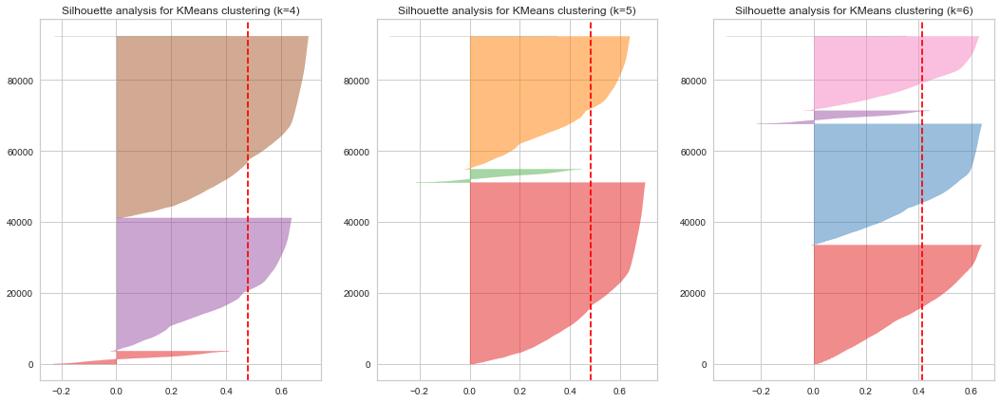

Wall time: 12min 4s


In [229]:
%%time
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from yellowbrick.cluster import SilhouetteVisualizer

# Les différents nombres de cluster à tester
cluster_range = range(4, 7)

# Creation de la figure et des subplots
fig, axs = plt.subplots(1, len(cluster_range), figsize=(6 * len(cluster_range), 7))

for i, k in enumerate(cluster_range):
    # clustering model et visualizer pourk clusters
    model = KMeans(k, n_init=10, random_state=0)
    visualizer =  SilhouetteVisualizer(model, ax=axs[i])

    # Fit des données to
    visualizer.fit(segment_1_scaled)
    #visualizer.show()

    # Set the title of the subplot
    axs[i].set_title(f"Silhouette analysis for KMeans clustering (k={k})")

# Display the plot
plt.show()

On voit bien les 4 clusters en haut mais si on prends 5 clusters on ne voit pas bien et le 6 eme aussi, on ira vers un nombre des clusters plus petit 

In [230]:
import warnings
warnings.filterwarnings("ignore")

In [231]:
%%time
kmeans = KMeans(n_clusters=4, n_init=10)
kmeans.fit(segment_1_scaled)
clusters = kmeans.labels_
segment_1['cluster'] = clusters
segment_1['cluster'] = segment_1['cluster'].astype("category")  

Wall time: 878 ms


In [232]:
segment_1['cluster'].value_counts()

2    51273
3    37551
0     3645
1       24
Name: cluster, dtype: int64

In [233]:
segment_1.columns

Index(['customer_unique_id', 'Nb_inactive_days', 'frequency', 'montant',
       'cluster'],
      dtype='object')

In [234]:
import plotly.express as px
fig = px.scatter_3d(segment_1, x="Nb_inactive_days", y="frequency", z="montant", color="cluster")
fig.show()

Wall time: 921 ms


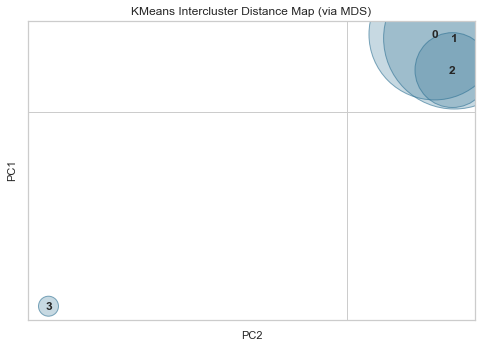

In [235]:
%%time
# optimal number of clusters: intercluster distances
from yellowbrick.cluster import InterclusterDistance
visD = InterclusterDistance(
     KMeans(n_clusters=4, n_init=10), max_size=20000, legend=False, random_state=0)
visD.fit(segment_1_scaled)
visD.finalize()

### Caractérisation de chaque cluster

On peut faire un groupby -> 4 clusters -> on regarde les statistiques pour les différents cluster et le cluster 0 par exemple symbolise les clients qui en moyenne ont une recence grande (recence=nb_inactive_days) c'est des clients qui restent plus d'une année sans commander et c'est des personnes qui commande une fois et c'est celles qui ont les faibles montants. C'est les clients qui sont inactifs 

In [236]:
segment_1.groupby('cluster').agg({'Nb_inactive_days' : ['min', 'max', 'median','mean'],
                            'frequency' : ['min', 'max', 'median','mean'],
                            'montant' : ['min', 'max', 'median','mean'],
                           })

Nb_inactive_days                         frequency             \
                     min  max median        mean       min max median   
cluster                                                                 
0                      0  694  214.0  230.095199         1  38    3.0   
1                     21  575  245.0  229.625000         4  75   10.0   
2                      0  257  128.0  127.178281         1   3    1.0   
3                    257  694  375.0  387.225773         1   3    1.0   

                   montant                                     
              mean     min        max    median          mean  
cluster                                                        
0         4.088066   19.00   12490.88    628.50   1096.396711  
1        14.250000  556.13  109312.64  18917.13  23827.422917  
2         1.114232    9.59    3526.46    109.76    169.178567  
3         1.123166   10.07    4042.74    106.78    169.760669

In [237]:
segment_1.shape

(92493, 5)

In [ ]:
segment_1['profil client'] = segment_1['cluster'].map({ 0: 'Bons clients (cluster 0)' , 3:'Clients inactifs (cluster 3)', 2:'Clients réguliers mais peu dépensiers (cluster 2)', 1 :'Clients très dépensiers (cluster 1)'})

In [ ]:
import colorlover as cl
import plotly.graph_objects as go
#colors = cl.scales['9']['seq']['Blues']
colors = ['#FF0000', '#ff8000', '#00FF00', '##50C878']
fig = go.Figure( data = [go.Pie(values = segment_1['profil client'].value_counts().values,
                                labels = segment_1['profil client'].value_counts().index,
                                title = 'profil client',
                                hole = .5,
                                textinfo='label+percent',
                                marker=dict(colors=colors),)
                                
                        ])
fig.update_layout(width=800, height=600)

fig.show()

In [240]:
data=segment_1.groupby('cluster').agg({'Nb_inactive_days' :  'mean',
                            'frequency' : 'mean',
                            'montant' :  'mean',
                           }).reset_index()

data

,cluster,Nb_inactive_days,frequency,montant
0,0,230.095199,4.088066,1096.396711
1,1,229.625000,14.250000,23827.422917
2,2,127.178281,1.114232,169.178567
3,3,387.225773,1.123166,169.760669


In [241]:
segment_1['cluster'].value_counts()

2    51273
3    37551
0     3645
1       24
Name: cluster, dtype: int64

In [242]:
data

import pandas as pd
import plotly.graph_objects as go
from sklearn.preprocessing import MinMaxScaler

# Charger les données
df = data

# Sélectionner les variables à visualiser
variables = ['Nb_inactive_days', 'frequency', 'montant']

# Créer le scaler
scaler = MinMaxScaler()

# Appliquer le scaler sur les données
scaled_data = scaler.fit_transform(df[variables])

# Créer le dataframe avec les données scalées
df_scaled = pd.DataFrame(scaled_data, columns=variables)

# Ajouter la colonne cluster
df_scaled['cluster'] = df['cluster'].values

# Créer un dataframe pour chaque cluster
clusters = df_scaled.groupby('cluster')

# Récupérer les noms des clusters
cluster_names = df_scaled['cluster'].unique()

# Créer la figure Plotly
fig = go.Figure()

# Parcourir les clusters et ajouter chaque radar plot à la figure
for i, cluster in enumerate(clusters):
    data = cluster[1][variables].mean().values.flatten().tolist()
    data += data[:1]
    fig.add_trace(go.Scatterpolar(
        r=data,
        theta=variables + [variables[0]],
        fill='toself',
        name=f'Cluster {cluster_names[i]}'
    ))

# Ajouter le titre et les étiquettes des axes
fig.update_layout(
    title='Radar plot des clusters',
    polar=dict(
        radialaxis=dict(
            visible=True,
            range=[0, 1]
        ),
    ),
    showlegend=True,

    width=800,
    height=600
)

# Afficher la figure
fig.show()

In [243]:
import sklearn.decomposition

from sklearn import decomposition

In [244]:
pca=decomposition.PCA(n_components=2)
pca.fit (segment_1_scaled)
print( pca.explained_variance_ratio_.cumsum() )

[0.45974296 0.79312328]


In [245]:
X_trans =pca.transform (segment_1_scaled)

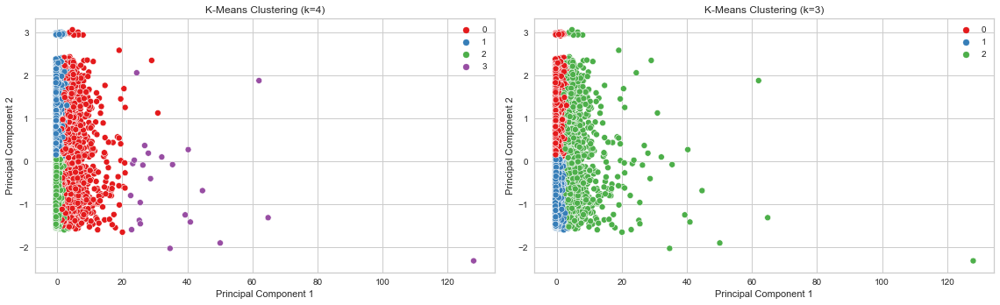

In [246]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

fig = plt.figure(figsize=(16,5))
# K-Means Clustering with k=4
cls4 = KMeans(n_clusters=4, n_init=10)
cls4.fit(segment_1_scaled)

# Plot 1 - K-Means Clustering (k=4)
plt.subplot(1, 2, 1)
sns.scatterplot(x=X_trans[:,0], y=X_trans[:,1], hue=cls4.labels_, palette='Set1')
sns.set_style("whitegrid")
plt.title('K-Means Clustering (k=4)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')

# K-Means Clustering with k=3
cls3 = KMeans(n_clusters=3, n_init=10)
cls3.fit(segment_1_scaled)

# Plot 2 - K-Means Clustering (k=3)
plt.subplot(1, 2, 2)
sns.scatterplot(x=X_trans[:,0], y=X_trans[:,1], hue=cls3.labels_, palette='Set1')
sns.set_style("whitegrid")
plt.title('K-Means Clustering (k=3)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')

# Adjust layout and show plot
plt.tight_layout()
plt.show()

In [247]:
from yellowbrick.cluster import SilhouetteVisualizer
segment_2_copy=segment_2.drop(['customer_unique_id'], axis=1).copy()
segment_2_scaled = StandardScaler().fit_transform (segment_2_copy)

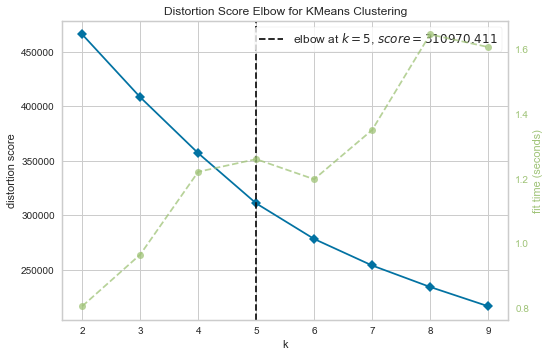



Nombre optimal de clusters pour segment_2 :  5
Score de silhouette pour segment_2 :  0.2756799783593603
Labels de clusters pour segment_2 :  [0 0 1 ... 1 0 1]
Wall time: 2min 11s


In [248]:
%%time
# Pour segment_1
model =KMeans(random_state=0,n_init=10)
visualizer_1 = KElbowVisualizer(model, k=(2, 10))
visualizer_1.fit(segment_2_scaled)
visualizer_1.show()


kmeans_1 = KMeans(n_clusters=visualizer_1.elbow_value_, random_state=0,n_init=10).fit(segment_2_scaled)
labels_1 = kmeans_1.labels_  # je peux utliser kmeans_1.predict (segement_1_sample)
score_1 = silhouette_score(segment_2_scaled, labels_1)

print("\n")
print("Nombre optimal de clusters pour segment_2 : ", visualizer_1.elbow_value_)
print("Score de silhouette pour segment_2 : ", score_1)
print("Labels de clusters pour segment_2 : ", labels_1)

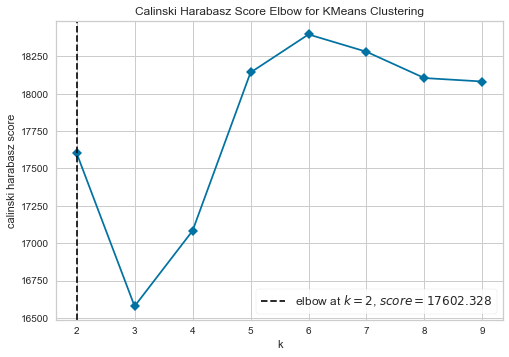

<AxesSubplot:title={'center':'Calinski Harabasz Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='calinski harabasz score'>

In [249]:
visualizer_1 = KElbowVisualizer(model, k=(2, 10), metric='calinski_harabasz', timings=False)
visualizer_1.fit(segment_2_scaled)
visualizer_1.show()
#plt.title('Elbow method pour segment_1')

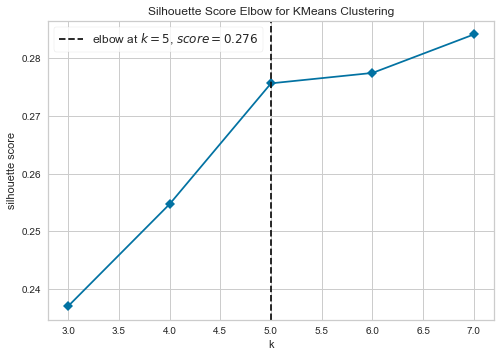

Wall time: 9min 28s


<AxesSubplot:title={'center':'Silhouette Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='silhouette score'>

In [250]:
%%time
visualizer_1 = KElbowVisualizer(model, k=(3, 8), metric='silhouette', timings=False)
visualizer_1.fit(segment_2_scaled)
visualizer_1.show()
#plt.title('Elbow method pour segment_1')

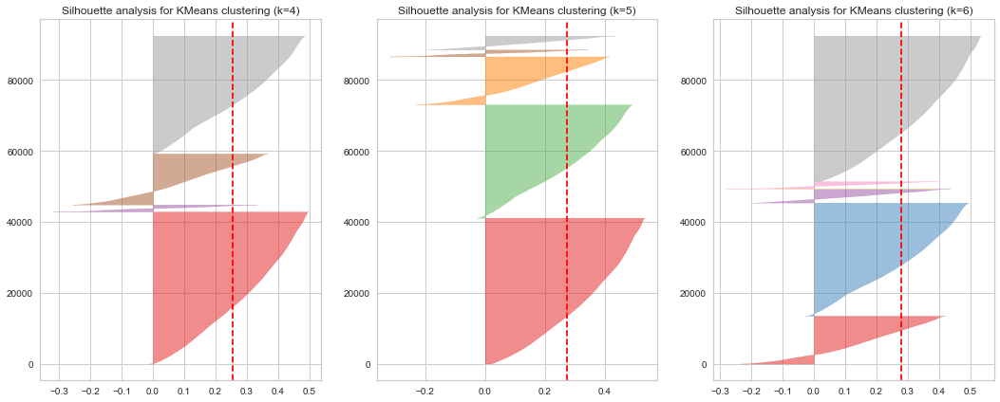

Wall time: 11min 23s


In [251]:
%%time
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from yellowbrick.cluster import SilhouetteVisualizer

# Les différents nombres de cluster à tester
cluster_range = range(4, 7)

# Creation de la figure et des subplots
fig, axs = plt.subplots(1, len(cluster_range), figsize=(6 * len(cluster_range), 7))

for i, k in enumerate(cluster_range):
    # clustering model et visualizer pourk clusters
    model = KMeans(k, n_init=10, random_state=0)
    visualizer =  SilhouetteVisualizer(model, ax=axs[i])

    # Fit des données to
    visualizer.fit(segment_2_scaled)
    #visualizer.show()

    # Set the title of the subplot
    axs[i].set_title(f"Silhouette analysis for KMeans clustering (k={k})")

# Display the plot
plt.show()

In [252]:
#Nombre de cluster choisi
nombre_cluster = 5

In [253]:
%%time
#model.fit(scaler.fit_transform (segment_2))
model = KMeans(nombre_cluster, n_init=10, random_state=0)
model.fit(segment_2_scaled)
clusters = model.labels_
segment_2["cluster"] = clusters
segment_2['cluster'] = segment_2['cluster'].astype("category")  

Wall time: 1.07 s


In [254]:
segment_2['cluster count'] = segment_2['cluster']

In [255]:
data1 =segment_2.groupby('cluster').agg({'Nb_inactive_days' : 'mean',
                                'frequency' : 'mean',
                                'montant' : 'mean',
                                'note_com' : 'mean',
                                'frais_livraison' : 'mean',
                                'temps_moyen_livraison' : 'mean',
                                'cluster count':'count'
                               }).reset_index()
data1.style.background_gradient(cmap='YlGnBu')
data1.rename(columns={'Nb_inactive_days':'recency'}).style.background_gradient(cmap='YlGnBu')

,cluster,recency,frequency,montant,note_com,frais_livraison,temps_moyen_livraison,cluster count
0,0,122.984321,1.137898,151.859692,4.643550,17.172908,9.253361,41139
1,1,390.372743,1.141570,157.590317,4.596661,17.503821,11.053061,31963
2,2,232.949439,1.247269,201.144655,1.644665,19.818049,21.863596,13548
3,3,242.124673,5.227344,1790.877444,3.709360,19.716619,11.360398,1909
4,4,190.794103,1.111337,556.403592,4.275758,74.640649,15.960346,3934


In [256]:
segment_2['profil client'] = segment_2['cluster'].map({ 0: 'clients tièdes (cluster 0)', 1:'Satisfait-peu actifs (cluster 1)', 2:'Mécontents-peu actifs (cluster 2)', 3 :'Très bons clients (cluster 3)', 4: 'Bons clients (cluster4)'})
import colorlover as cl
#colors = cl.scales['9']['seq']['Blues']
colors = ['#ff8000','#FBB124', '#FF0000', '#90EE90', '#00ab41']
fig = go.Figure( data = [go.Pie(values = segment_2['profil client'].value_counts().values,
                                labels = segment_2['profil client'].value_counts().index,
                                title = 'profil client',
                                hole = .5,
                                textinfo='label+percent',
                                marker=dict(colors=colors),)
                                
                        ])
fig.update_layout(width=800, height=600)

fig.show()

In [257]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go
# Charger les données
df = data1

# Sélectionner les variables à visualiser
variables = ['Nb_inactive_days', 'frequency', 'montant', 'note_com', 'frais_livraison', 'temps_moyen_livraison']

# Créer le scaler

# Appliquer le scaler sur les données
scaled_data = MinMaxScaler().fit_transform(df[variables])

# Créer le dataframe avec les données scalées
df_scaled = pd.DataFrame(scaled_data, columns=variables)

# Ajouter la colonne cluster
df_scaled['cluster'] = df['cluster'].values

# Créer un dataframe pour chaque cluster
clusters = df_scaled.groupby('cluster')

# Récupérer les noms des clusters
cluster_names = df_scaled['cluster'].unique()

# Créer une figure Plotly avec 6 sous-figures polar
fig = make_subplots(rows=2, cols=3, subplot_titles=[f'Cluster {name}' for name in cluster_names], specs=[[{'type': 'polar'}]*3]*2, horizontal_spacing=0.001, vertical_spacing=0.2)

# Parcourir les clusters et ajouter un radar plot à chaque sous-figure
for i, cluster in enumerate(clusters):
    data11 = cluster[1][variables].mean().values.flatten().tolist()
    data11 += data11[:1]

    fig.add_trace(go.Scatterpolar(
        r=data11,
        theta=variables + [variables[0]],
        fill='toself',
        name=f'Cluster {cluster_names[i]}'
    ), row=(i // 3) + 1, col=(i % 3) + 1)

    # Ajouter les étiquettes des axes pour chaque sous-figure
    fig.update_layout(
        polar=dict(
            radialaxis=dict(
                visible=True,
                range=[0, 1]
            ),
        ),
        showlegend=True,
        width=1800,
        height=900
    )

# Mettre à jour le titre de la figure
fig.update_layout(title_text='Radar plot des clusters')

# Afficher la figure
fig.show()

In [258]:
pca=decomposition.PCA(n_components=3)
pca.fit (segment_2_scaled)
print( pca.explained_variance_ratio_.cumsum() )

[0.25477342 0.47107023 0.64649318]


In [259]:
X_trans =pca.transform (segment_2_scaled)

In [260]:
import plotly.graph_objs as go

# K-Means Clustering with k=5
#cls5 = KMeans(n_clusters=5, n_init=10)
#cls5.fit(segment_2_scaled)

fig = go.Figure(data=[go.Scatter3d(x=X_trans[:,0], y=X_trans[:,1], z=X_trans[:,2],
                                   mode='markers',
                                   marker=dict(color=model.labels_, 
                                               colorscale='Viridis', 
                                               opacity=0.8)
                                  )
                     ])

fig.update_layout(scene=dict(xaxis_title='Principal Component 1',
                             yaxis_title='Principal Component 2',
                             zaxis_title='Principal Component 3'),
                  title='K-Means Clustering (k=5)')

fig.show()


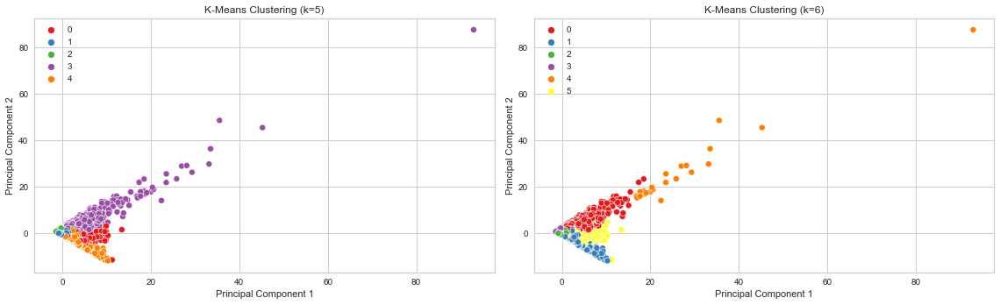

In [261]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

fig = plt.figure(figsize=(16,5))
# K-Means Clustering with k=5
cls4 = KMeans(n_clusters=5, n_init=10)
cls4.fit(segment_2_scaled)

# Plot 1 - K-Means Clustering (k=5)
plt.subplot(1, 2, 1)
sns.scatterplot(x=X_trans[:,0], y=X_trans[:,1], hue=cls4.labels_, palette='Set1')
sns.set_style("whitegrid")
plt.title('K-Means Clustering (k=5)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')

# K-Means Clustering with k=6
cls3 = KMeans(n_clusters=6, n_init=10)
cls3.fit(segment_2_scaled)

# Plot 2 - K-Means Clustering (k=6)
plt.subplot(1, 2, 2)
sns.scatterplot(x=X_trans[:,0], y=X_trans[:,1], hue=cls3.labels_, palette='Set1')
sns.set_style("whitegrid")
plt.title('K-Means Clustering (k=6)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')

# Adjust layout and show plot
plt.tight_layout()
plt.show()

Wall time: 2.25 s


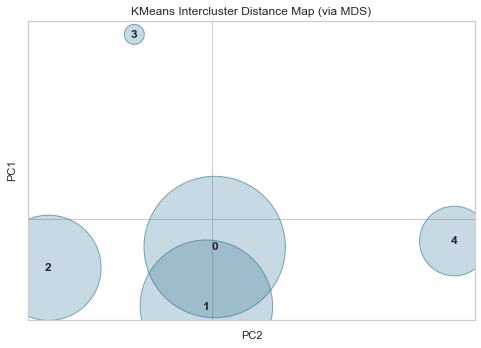

In [262]:
%%time
# optimal number of clusters: intercluster distances
from yellowbrick.cluster import InterclusterDistance
visD = InterclusterDistance(
     KMeans(nombre_cluster, n_init=10, random_state=0), max_size=20000, legend=False, random_state=0)
visD.fit(segment_2_scaled)
visD.finalize()

In [263]:
segment_2

,customer_unique_id,Nb_inactive_days,frequency,montant,note_com,frais_livraison,temps_moyen_livraison,cluster,cluster count,profil client
0,0000366f3b9a7992bf8c76cfdf3221e2,111,1,141.90,5.0,12.00,6.0,0,0,clients tièdes (cluster 0)
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,27.19,4.0,8.29,3.0,0,0,clients tièdes (cluster 0)
2,0000f46a3911fa3c0805444483337064,536,1,86.22,3.0,17.22,25.0,1,1,Satisfait-peu actifs (cluster 1)
3,0000f6ccb0745a6a4b88665a16c9f078,320,1,43.62,4.0,17.63,20.0,1,1,Satisfait-peu actifs (cluster 1)
4,0004aac84e0df4da2b147fca70cf8255,287,1,196.89,5.0,16.89,13.0,1,1,Satisfait-peu actifs (cluster 1)
...,...,...,...,...,...,...,...,...,...,...
92488,fffcf5a5ff07b0908bd4e2dbc735a684,446,2,4134.84,5.0,248.71,27.0,4,4,Bons clients (cluster4)
92489,fffea47cd6d3cc0a88bd621562a9d061,261,1,84.58,4.0,19.69,30.0,2,2,Mécontents-peu actifs (cluster 2)
92490,ffff371b4d645b6ecea244b27531430a,567,1,112.46,5.0,22.56,14.0,1,1,Satisfait-peu actifs (cluster 1)
92491,ffff5962728ec6157033ef9805bacc48,118,1,133.69,5.0,18.69,11.0,0,0,clients tièdes (cluster 0)


In [264]:
segment_2.dtypes

customer_unique_id         object
Nb_inactive_days            int64
frequency                   int64
montant                   float64
note_com                  float64
frais_livraison           float64
temps_moyen_livraison     float64
cluster                  category
cluster count            category
profil client            category
dtype: object

In [265]:
print(type(segment_2))

<class 'pandas.core.frame.DataFrame'>


In [266]:
print(type(data))

<class 'list'>


In [267]:
data

[0.9999999999999998,
 0.0006801403381384713,
 2.4604582226399156e-05,
 0.9999999999999998]

In [268]:
repeated_values = [data[col] * 4 for col in data]

TypeError: list indices must be integers or slices, not float

In [ ]:
data_df = pd.DataFrame(repeated_values, columns=data.keys()).T

In [ ]:
data_df = pd.DataFrame(data, columns=['customer_unique_id','Nb_inactive_days','frequency','montant','note_com','frais_livraison','temps_moyen_livraison','Alimentation et Boissons','Auto et Moto','Autres','Livres et Médias','Maison et Jardin','Mode','Santé et Beauté','Sports et Loisirs','Électronique'])  

In [ ]:
#Merge entre segment_2 et data
df_merged = pd.merge(segment_2, data, on='customer_unique_id', how='left')

In [ ]:
df_cluster=df_merged.groupby ('cluster').agg({'Nb_inactive_days_x' : 'mean',
                                'frequency_x' : 'mean',
                                'montant_x' : 'mean',
                                'note_com_x' : 'mean',
                                'frais_livraison_x' : 'mean',
                                'temps_moyen_livraison_x' : 'mean',
                                'Alimentation et Boissons' :'sum',
                                'Auto et Moto':'sum',
                                'Livres et Médias':'sum',
                                'Maison et Jardin': 'sum',
                                'Mode': 'sum',
                                'Santé et Beauté': 'sum',
                                'Sports et Loisirs':'sum',
                                'Électronique':'sum',
                                'Autres':'sum'

                               })

In [ ]:
va=['Alimentation et Boissons', 'Auto et Moto', 'Livres et Médias', 'Maison et Jardin', 'Mode', 'Santé et Beauté', 'Sports et Loisirs', 'Électronique', 'Autres']

# On calcule la somme de toutes les colonnes de va
df_cluster['total_category'] = df_cluster[va].sum(axis=1)

# On normalise chaque colonne de va par la somme totale
for v in va:
  df_cluster[v] = round((df_cluster[v] / df_cluster['total_category']) * 100, 2)

# On supprime la colonne 'total_category'
#df_cluster.drop('total_category', axis=1, inplace=True)"""

# On affiche le dataframe modifié
df_cluster

In [ ]:
import matplotlib.pyplot as plt

# Définir les noms de colonnes à tracer
va=['Alimentation et Boissons', 'Auto et Moto', 'Livres et Médias', 'Maison et Jardin', 'Mode', 'Santé et Beauté', 'Sports et Loisirs', 'Électronique', 'Autres']

# Créer une figure avec une grille de sous-graphiques pour chaque cluster
fig, axs = plt.subplots(nrows=1, ncols=len(df_cluster.index), figsize=(20, 5))

# Pour chaque cluster, tracer un histogramme pour chaque variable dans un sous-graphique
for i in range(len(df_cluster.index)):
    cluster_df = df_cluster.loc[[i], :]
    ax = axs[i]
    cluster_df[va].T.plot(kind='bar', legend=None, ax=ax)
    ax.set_title(f'Cluster {i}')
    ax.set_xlabel('Variable')
    ax.set_ylabel('Pourcentage')
    plt.setp(ax.get_xticklabels(), rotation=45, ha='right')

# Afficher les graphiques
plt.tight_layout()
plt.show()
